# 1.. Setup & Imports

In [ ]:
# Install Ultralytics for YOLO
!pip install ultralytics -q

# Import all necessary libraries
import os
import cv2
import random
import numpy as np
import matplotlib.pyplot as plt
from glob import glob

# Import libraries for Part 1
from skimage.exposure import equalize_adapthist, rescale_intensity

# Import libraries for Part 2B (Semantic Segmentation)
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Dropout, Conv2DTranspose, concatenate

# Import Ultralytics
from ultralytics import YOLO
from IPython.display import Image

In [2]:
%%writefile /kaggle/working/data.yaml
# ============================================================
# YOLOv12 Dataset Configuration for Instance Segmentation
# ============================================================

train:/kaggle/input/microscopic-yolov8/train/images
val:/kaggle/input/microscopic-yolov8/valid/images
test:/kaggle/input/microscopic-yolov8/test/images

# Number of classes
nc: 3

# Class names
names: ['blood_vessel', 'glomerulus', 'unsure']

Writing /kaggle/working/data.yaml


## 2.1. Load Sample Images

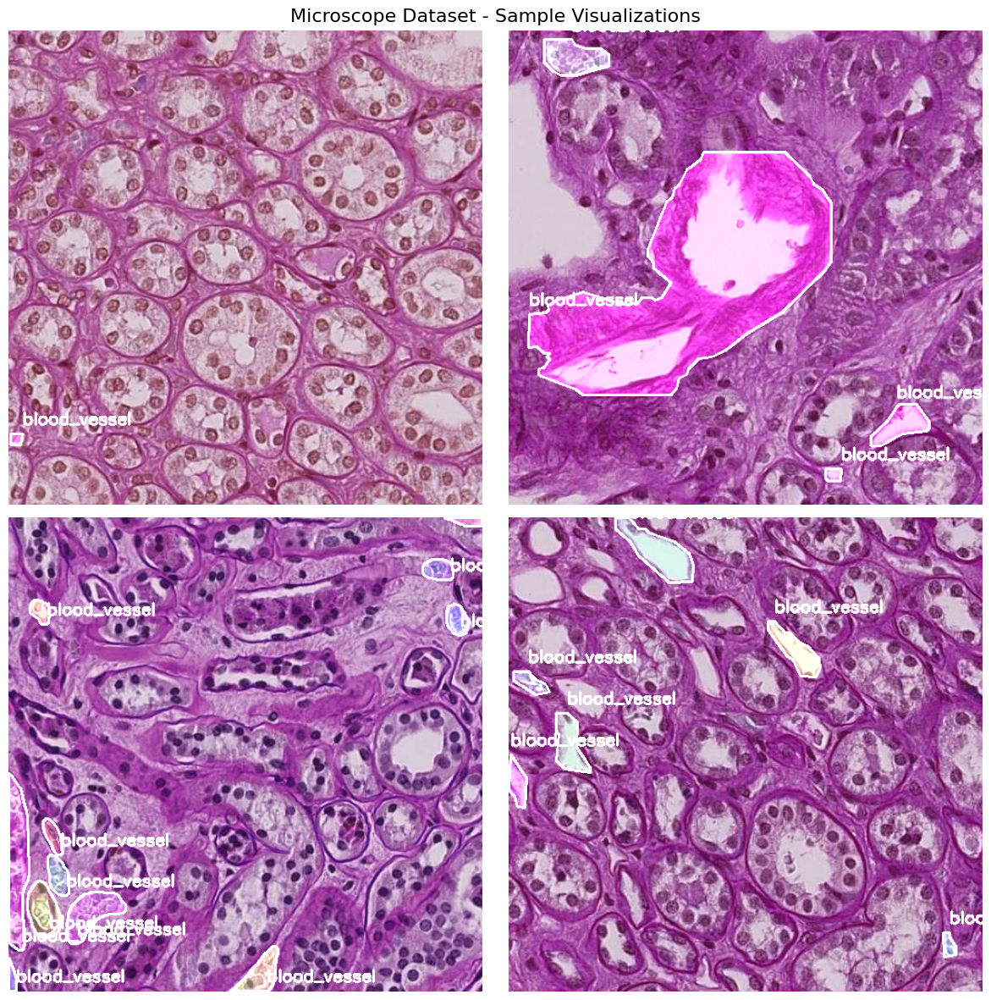

In [5]:
import os, random, cv2
import numpy as np
import matplotlib.pyplot as plt

# ============================================================
# Fixed Instance Segmentation Visualization (Final Stable)
# ============================================================

image_dir = "/kaggle/input/microscopic-yolov8/train/images"
label_dir = "/kaggle/input/microscopic-yolov8/train/labels"

CLASS_NAMES = ['blood_vessel', 'glomerulus', 'unsure']

image_files = random.sample(os.listdir(image_dir), 4)

def visualize_image(img_path, label_path, class_names):
    """Visualize one image with segmentation masks or bboxes."""
    img = cv2.imread(img_path)
    if img is None:
        return np.zeros((100, 100, 3), dtype=np.uint8)

    h, w = img.shape[:2]
    overlay = img.copy()

    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            lines = f.readlines()

        for line in lines:
            values = list(map(float, line.strip().split()))
            if len(values) < 5:  # must have at least class + coords
                continue

            # ✅ FIXED LINE
            cls_id = int(values[0])     # take only first value
            coords = values[1:]         # remaining values are coordinates

            # Validate class id
            if cls_id < 0 or cls_id >= len(class_names):
                continue

            class_name = class_names[cls_id]
            color = tuple(np.random.randint(0, 255, 3).tolist())

            # Polygon segmentation
            if len(coords) > 4:
                pts = np.array(coords, dtype=np.float32).reshape(-1, 2)
                pts[:, 0] *= w
                pts[:, 1] *= h
                pts = np.round(pts).astype(np.int32)
                pts_reshaped = pts.reshape((-1, 1, 2))

                # Draw filled polygon with transparency
                mask = np.zeros_like(img, dtype=np.uint8)
                cv2.fillPoly(mask, [pts_reshaped], color)
                overlay = cv2.addWeighted(overlay, 1.0, mask, 0.4, 0)
                cv2.polylines(overlay, [pts_reshaped], True, (255, 255, 255), 2)

                # Add label
                x_text, y_text = pts[0]
                cv2.putText(overlay, class_name, (x_text, max(y_text - 10, 0)),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2)

            else:
                # Bounding box fallback
                if len(coords) != 4:
                    continue
                xc, yc, bw, bh = coords
                x1, y1 = int((xc - bw / 2) * w), int((yc - bh / 2) * h)
                x2, y2 = int((xc + bw / 2) * w), int((yc + bh / 2) * h)
                cv2.rectangle(overlay, (x1, y1), (x2, y2), color, 2)
                cv2.putText(overlay, class_name, (x1, max(y1 - 5, 0)),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)

    return overlay


# ====== DISPLAY IMAGES ======
plt.figure(figsize=(12, 12))
for idx, img_file in enumerate(image_files):
    img_path = os.path.join(image_dir, img_file)
    label_path = os.path.join(label_dir, img_file.replace(".jpg", ".txt").replace(".png", ".txt"))
    
    vis = visualize_image(img_path, label_path, CLASS_NAMES)
    plt.subplot(2, 2, idx + 1)
    plt.imshow(cv2.cvtColor(vis, cv2.COLOR_BGR2RGB))
    plt.axis("off")

plt.suptitle("Microscope Dataset - Sample Visualizations", fontsize=16)
plt.tight_layout()
plt.show()


# 2 Part 1: Intensity Transformations and Filtering

## 2.1. Load Sample Images

Scanning for class examples...
  Found 'blood_vessel' in ae5316fb9320_png.rf.41730d52a33a1c07d7624b9c655e1cb8.jpg
  Found 'glomerulus' in f7e99dc711e5_png.rf.fb9ca076905d5de205723099197c18a4.jpg
  Found 'unsure' in 0033bbc76b6b_png.rf.5c3a8337375eb35f7a17f813deff41ec.jpg


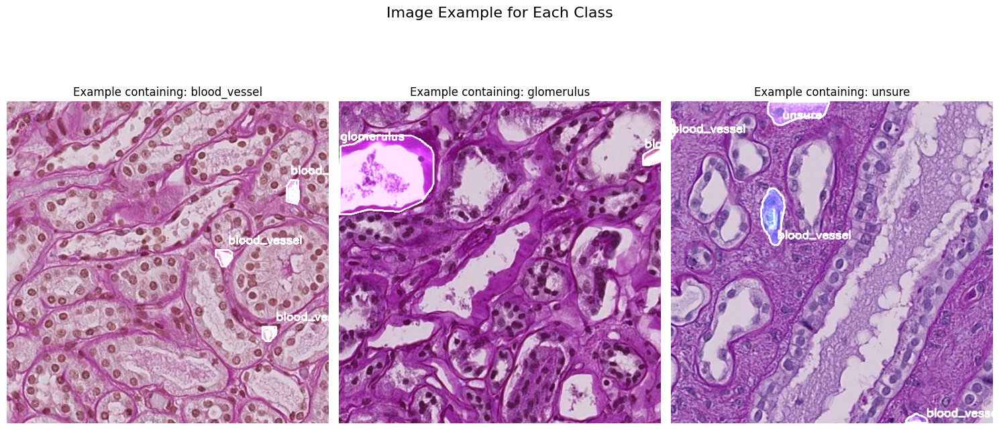

In [8]:
import os
import cv2
import random
import numpy as np
import matplotlib.pyplot as plt

# ============================================================
# Define Paths and Class Names (from your notebook)
# ============================================================
IMAGE_DIR = "/kaggle/input/microscopic-yolov8/train/images"
LABEL_DIR = "/kaggle/input/microscopic-yolov8/train/labels"
CLASS_NAMES = ['blood_vessel', 'glomerulus', 'unsure']

# ============================================================
# Helper Visualization Function (from your notebook)
# ============================================================
def visualize_image(img_path, label_path, class_names):
    """Visualize one image with segmentation masks or bboxes."""
    img = cv2.imread(img_path)
    if img is None:
        return np.zeros((100, 100, 3), dtype=np.uint8)

    h, w = img.shape[:2]
    overlay = img.copy()

    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            lines = f.readlines()

        for line in lines:
            values = list(map(float, line.strip().split()))
            if len(values) < 5:  # must have at least class + coords
                continue

            cls_id = int(values[0])
            coords = values[1:]

            if cls_id < 0 or cls_id >= len(class_names):
                continue

            class_name = class_names[cls_id]
            color = tuple(np.random.randint(0, 255, 3).tolist())

            if len(coords) > 4: # Polygon
                pts = np.array(coords, dtype=np.float32).reshape(-1, 2)
                pts[:, 0] *= w
                pts[:, 1] *= h
                pts = np.round(pts).astype(np.int32)
                pts_reshaped = pts.reshape((-1, 1, 2))

                mask = np.zeros_like(img, dtype=np.uint8)
                cv2.fillPoly(mask, [pts_reshaped], color)
                overlay = cv2.addWeighted(overlay, 1.0, mask, 0.4, 0)
                cv2.polylines(overlay, [pts_reshaped], True, (255, 255, 255), 2)

                x_text, y_text = pts[0]
                cv2.putText(overlay, class_name, (x_text, max(y_text - 10, 0)),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2)
            elif len(coords) == 4: # BBox
                xc, yc, bw, bh = coords
                x1, y1 = int((xc - bw / 2) * w), int((yc - bh / 2) * h)
                x2, y2 = int((xc + bw / 2) * w), int((yc + bh / 2) * h)
                cv2.rectangle(overlay, (x1, y1), (x2, y2), color, 2)
                cv2.putText(overlay, class_name, (x1, max(y1 - 5, 0)),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)
    return overlay

# ============================================================
# Find and Display One Image Per Class
# ============================================================

print("Scanning for class examples...")
class_image_map = {} # Stores { 'class_name': 'image_path' }
classes_to_find = set(CLASS_NAMES)
all_label_files = os.listdir(LABEL_DIR)
random.shuffle(all_label_files) # Shuffle to get different examples

for label_file in all_label_files:
    if not classes_to_find:
        break # Stop if we found all classes

    label_path = os.path.join(LABEL_DIR, label_file)
    try:
        with open(label_path, "r") as f:
            lines = f.readlines()
        
        found_classes_in_file = set()
        for line in lines:
            try:
                cls_id = int(line.strip().split()[0])
                found_classes_in_file.add(CLASS_NAMES[cls_id])
            except (ValueError, IndexError):
                continue

        # Check if this file contains a class we're still looking for
        newly_found_classes = classes_to_find.intersection(found_classes_in_file)

        for class_name in newly_found_classes:
            # Find the matching image file (.jpg or .png)
            img_name_base = os.path.splitext(label_file)[0]
            img_path_jpg = os.path.join(IMAGE_DIR, img_name_base + ".jpg")
            img_path_png = os.path.join(IMAGE_DIR, img_name_base + ".png")
            
            img_path = None
            if os.path.exists(img_path_jpg):
                img_path = img_path_jpg
            elif os.path.exists(img_path_png):
                img_path = img_path_png

            if img_path:
                class_image_map[class_name] = img_path
                classes_to_find.remove(class_name)
                print(f"  Found '{class_name}' in {os.path.basename(img_path)}")

    except Exception as e:
        print(f"Error processing {label_file}: {e}")

# --- Display the images ---
num_classes = len(CLASS_NAMES)
plt.figure(figsize=(max(15, 5 * num_classes), 7))

for i, class_name in enumerate(CLASS_NAMES):
    plt.subplot(1, num_classes, i + 1)
    if class_name in class_image_map:
        img_path = class_image_map[class_name]
        label_file = os.path.basename(img_path).replace(".jpg", ".txt").replace(".png", ".txt")
        label_path = os.path.join(LABEL_DIR, label_file)
        
        vis = visualize_image(img_path, label_path, CLASS_NAMES)
        plt.imshow(cv2.cvtColor(vis, cv2.COLOR_BGR2RGB))
        plt.title(f"Example containing: {class_name}")
    else:
        # Placeholder if no image was found for this class
        plt.imshow(np.zeros((100, 100), dtype=np.uint8), cmap='gray')
        plt.title(f"No image found for: {class_name}")
    
    plt.axis("off")

plt.suptitle("Image Example for Each Class", fontsize=16, y=1.02)
plt.tight_layout()
plt.show()

## 2.2. Apply Intensity Transformations

* We will apply Log, Gamma, CLAHE, and Contrast Stretching.

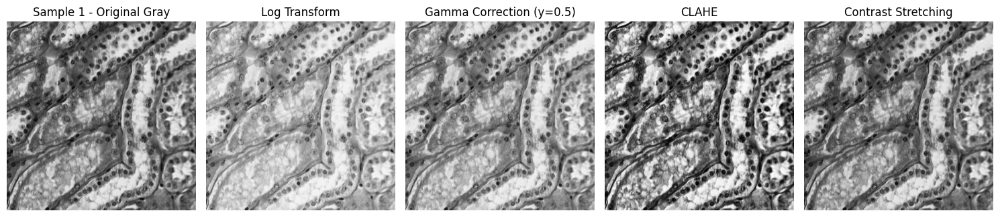

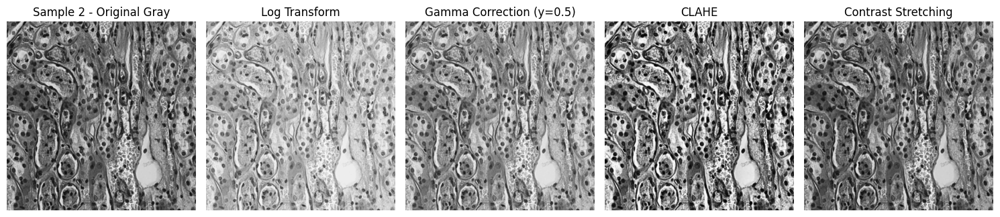

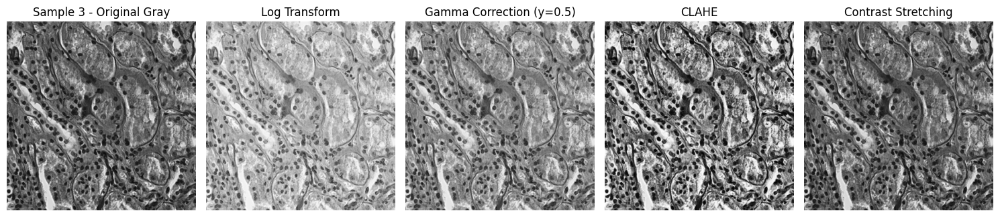

In [9]:
def plot_transformations(original_img, original_title="Original"):
    """Applies and plots the 4 required transformations."""
    
    # 1. Log Transformation
    c = 255 / np.log(1 + np.max(original_img))
    log_transformed = c * (np.log(original_img + 1))
    log_transformed = np.array(log_transformed, dtype=np.uint8)

    # 2. Gamma Correction (Power-Law)
    gamma = 0.5
    gamma_corrected = np.array(255 * (original_img / 255) ** gamma, dtype=np.uint8)

    # 3. Histogram Equalization (CLAHE)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    clahe_img = clahe.apply(original_img)
    
    # 4. Contrast Stretching
    contrast_stretched = rescale_intensity(original_img, in_range='image', out_range=(0, 255)).astype(np.uint8)

    # Plotting
    plt.figure(figsize=(15, 6))
    
    plt.subplot(1, 5, 1)
    plt.imshow(original_img, cmap='gray')
    plt.title(original_title)
    plt.axis('off')

    plt.subplot(1, 5, 2)
    plt.imshow(log_transformed, cmap='gray')
    plt.title("Log Transform")
    plt.axis('off')

    plt.subplot(1, 5, 3)
    plt.imshow(gamma_corrected, cmap='gray')
    plt.title(f"Gamma Correction (y={gamma})")
    plt.axis('off')

    plt.subplot(1, 5, 4)
    plt.imshow(clahe_img, cmap='gray')
    plt.title("CLAHE")
    plt.axis('off')
    
    plt.subplot(1, 5, 5)
    plt.imshow(contrast_stretched, cmap='gray')
    plt.title("Contrast Stretching")
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()

# Run the transformations on our 3 sample gray images
for i in range(len(images_gray)):
    plot_transformations(images_gray[i], original_title=f"Sample {i+1} - Original Gray")

## 2.3. Apply Filtering

* We will apply Gaussian Blur, Median Filter, and a Laplacian filter

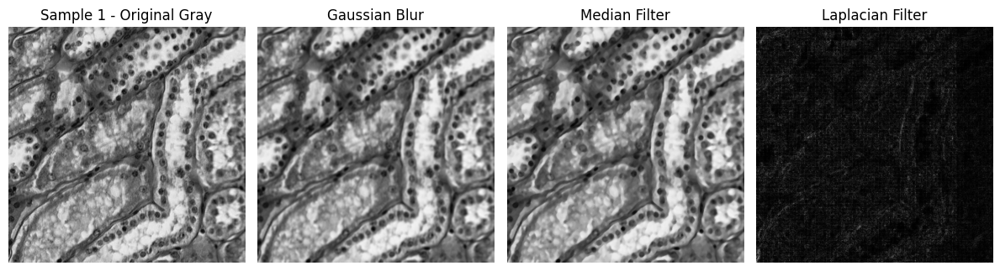

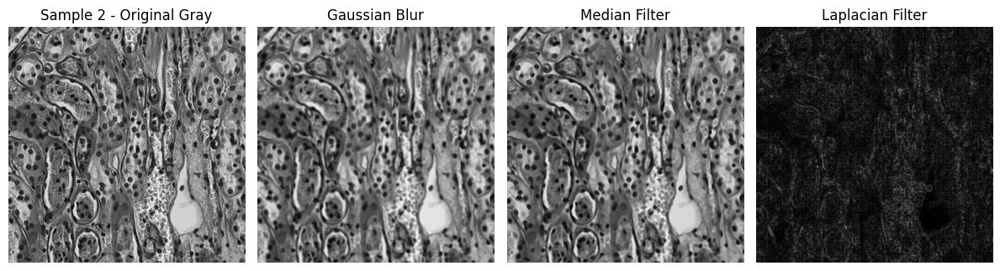

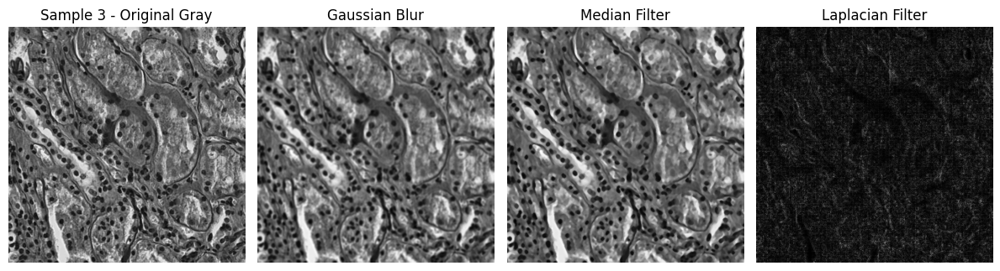

In [10]:
def plot_filters(original_img, original_title="Original"):
    """Applies and plots the 3 required filters."""
    
    # 1. Gaussian Blur (Mean/Average)
    gaussian_blur = cv2.GaussianBlur(original_img, (7, 7), 0)

    # 2. Median Filter
    median_blur = cv2.medianBlur(original_img, 5)

    # 3. Laplacian Filter (Edge Enhancement)
    laplacian = cv2.Laplacian(original_img, cv2.CV_64F)
    laplacian_abs = np.array(np.abs(laplacian), dtype=np.uint8)
    
    # Plotting
    plt.figure(figsize=(12, 4))
    
    plt.subplot(1, 4, 1)
    plt.imshow(original_img, cmap='gray')
    plt.title(original_title)
    plt.axis('off')

    plt.subplot(1, 4, 2)
    plt.imshow(gaussian_blur, cmap='gray')
    plt.title("Gaussian Blur")
    plt.axis('off')

    plt.subplot(1, 4, 3)
    plt.imshow(median_blur, cmap='gray')
    plt.title("Median Filter")
    plt.axis('off')

    plt.subplot(1, 4, 4)
    plt.imshow(laplacian_abs, cmap='gray')
    plt.title("Laplacian Filter")
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()

# Run the filters on our 3 sample gray images
for i in range(len(images_gray)):
    plot_filters(images_gray[i], original_title=f"Sample {i+1} - Original Gray")

# 3. Part 2: Segmentation

## Part 2A: Instance Segmentation (YOLO)

* We will use the YOLOv8-seg model from Ultralytics,

### 3.1.2. Create data.yaml

In [4]:
%%writefile /kaggle/working/data.yaml
# ============================================================
# YOLOv12 Dataset Configuration for Instance Segmentation
# (as per assignment guide [cite: 1, 2])
# ============================================================

train: /kaggle/input/microscopic-yolov8/train/images
val: /kaggle/input/microscopic-yolov8/valid/images
test: /kaggle/input/microscopic-yolov8/test/images

# Number of classes
nc: 3

# Class names
names: ['blood_vessel', 'glomerulus', 'unsure']

Overwriting /kaggle/working/data.yaml


### 3.1.3. Visualize Training Data

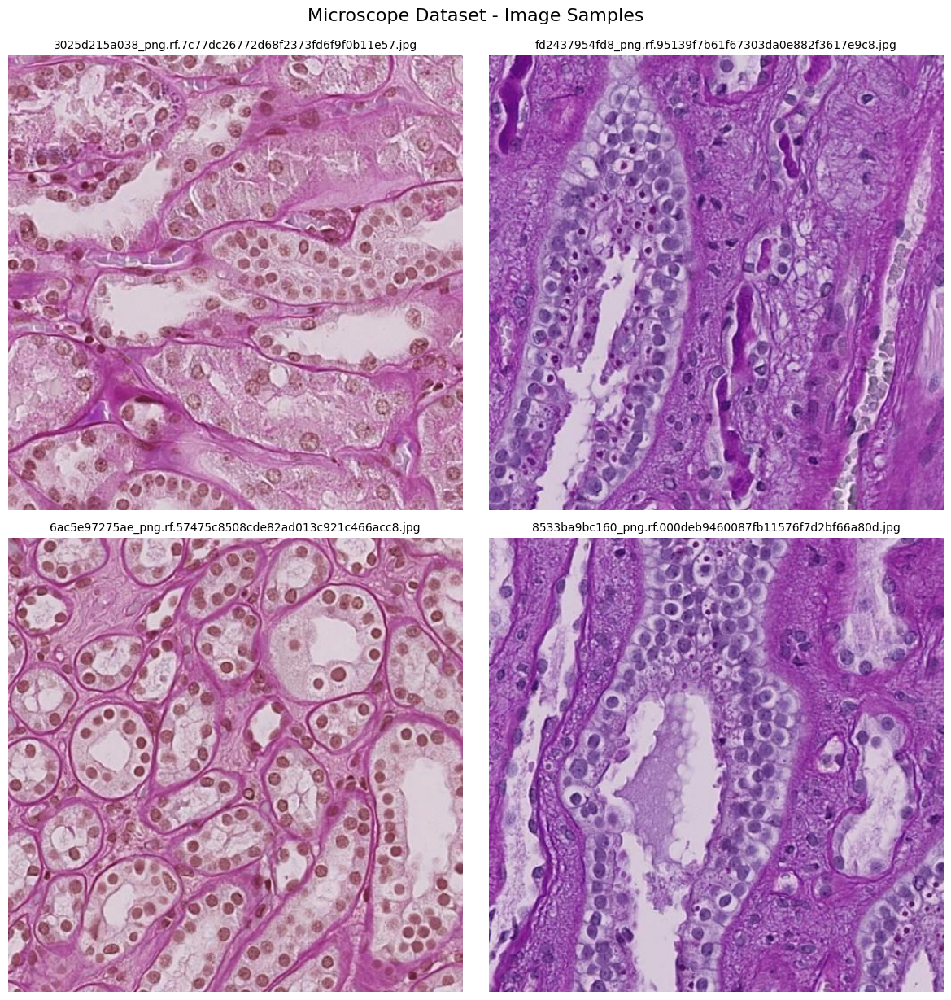

In [9]:
# ============================================================
# Simple & Safe Visualization (Images + Optional BBoxes)
# ============================================================
import os
import cv2
import random
import numpy as np
import matplotlib.pyplot as plt

# ============================================================
# Define Paths and Class Names
# ============================================================
IMAGE_DIR = "/kaggle/input/microscopic-yolov8/train/images"
LABEL_DIR = "/kaggle/input/microscopic-yolov8/train/labels"
CLASS_NAMES = ['blood_vessel', 'glomerulus', 'unsure']

def visualize_image(img_path, label_path, class_names):
    """Display image with bounding boxes if available."""
    img = cv2.imread(img_path)
    if img is None:
        return np.zeros((100, 100, 3), dtype=np.uint8)

    h, w = img.shape[:2]
    overlay = img.copy()

    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            lines = f.readlines()

        for line in lines:
            values = list(map(float, line.strip().split()))
            if len(values) != 5:
                # Skip malformed or segmentation lines
                continue

            cls_id, xc, yc, bw, bh = values
            cls_id = int(cls_id)

            if cls_id < 0 or cls_id >= len(class_names):
                continue

            class_name = class_names[cls_id]
            color = tuple(int(x) for x in np.random.randint(0, 255, 3))

            x1, y1 = int((xc - bw / 2) * w), int((yc - bh / 2) * h)
            x2, y2 = int((xc + bw / 2) * w), int((yc + bh / 2) * h)

            cv2.rectangle(overlay, (x1, y1), (x2, y2), color, 2)
            cv2.putText(overlay, class_name, (x1, max(y1 - 5, 0)),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)

    return overlay


# ============================================================
# Display Random Images
# ============================================================
image_files = random.sample(os.listdir(IMAGE_DIR), 4)

plt.figure(figsize=(12, 12))
for idx, img_file in enumerate(image_files):
    img_path = os.path.join(IMAGE_DIR, img_file)
    label_path = os.path.join(LABEL_DIR, img_file.replace(".jpg", ".txt").replace(".png", ".txt"))
    
    vis = visualize_image(img_path, label_path, CLASS_NAMES)
    plt.subplot(2, 2, idx + 1)
    plt.imshow(cv2.cvtColor(vis, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title(os.path.basename(img_file), fontsize=10)

plt.tight_layout()
plt.suptitle("Microscope Dataset - Image Samples", fontsize=16, y=1.02)
plt.show()


⚠️ Skipped invalid polygon in 7ed3c29e02c2_png.rf.feb94deaa01e134ae2d1750c44fa9979.txt: OpenCV(4.12.0) :-1: error: (-5:Bad argument) in function 'fillPoly'
> Overload resolution failed:
>  - img is not a numpy array, neither a scalar
>  - Expected Ptr<cv::UMat> for argument 'img'

⚠️ Skipped invalid polygon in 7ed3c29e02c2_png.rf.feb94deaa01e134ae2d1750c44fa9979.txt: OpenCV(4.12.0) :-1: error: (-5:Bad argument) in function 'fillPoly'
> Overload resolution failed:
>  - img is not a numpy array, neither a scalar
>  - Expected Ptr<cv::UMat> for argument 'img'

⚠️ Skipped invalid polygon in 7ed3c29e02c2_png.rf.feb94deaa01e134ae2d1750c44fa9979.txt: OpenCV(4.12.0) :-1: error: (-5:Bad argument) in function 'fillPoly'
> Overload resolution failed:
>  - img is not a numpy array, neither a scalar
>  - Expected Ptr<cv::UMat> for argument 'img'

⚠️ Skipped invalid polygon in 7ed3c29e02c2_png.rf.feb94deaa01e134ae2d1750c44fa9979.txt: OpenCV(4.12.0) :-1: error: (-5:Bad argument) in function 'fillPoly

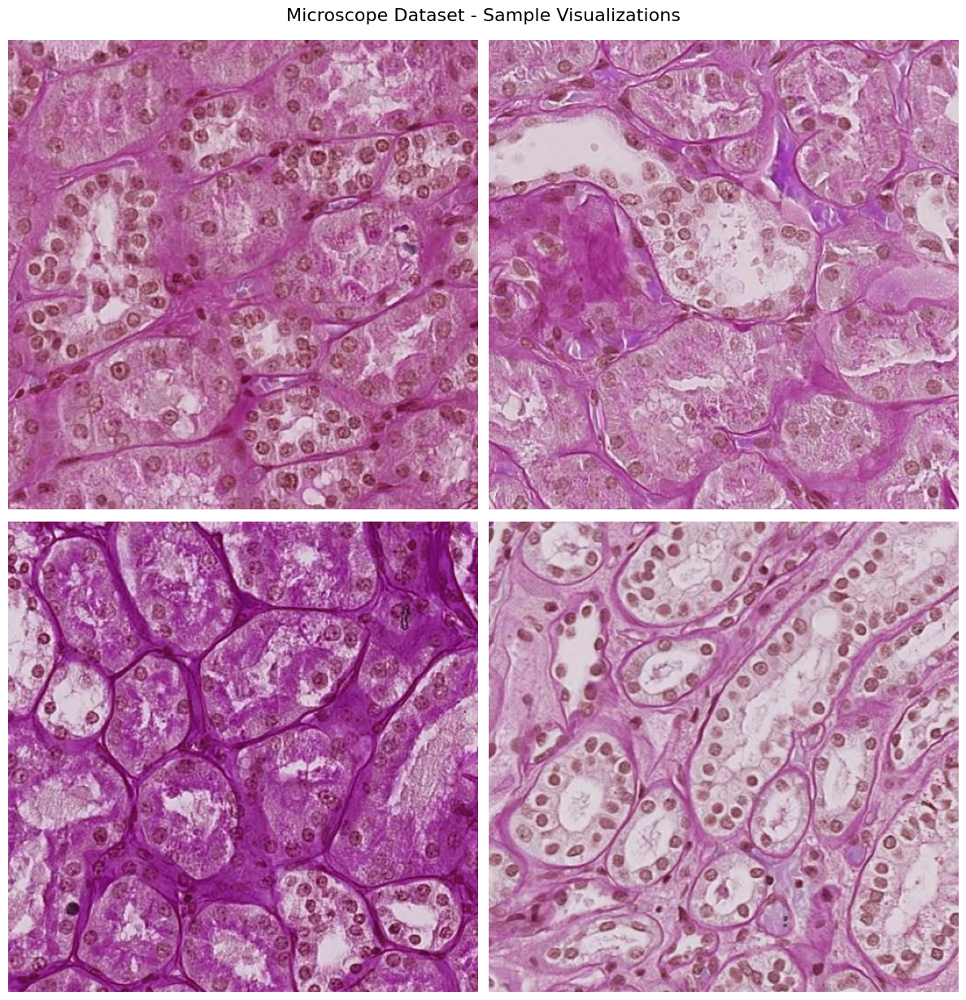

In [10]:
# ============================================================
# Fixed Instance Segmentation Visualization (Final Stable Version)
# ============================================================
import os
import cv2
import random
import numpy as np
import matplotlib.pyplot as plt

# ============================================================
# Define Paths and Class Names
# ============================================================
IMAGE_DIR = "/kaggle/input/microscopic-yolov8/train/images"
LABEL_DIR = "/kaggle/input/microscopic-yolov8/train/labels"
CLASS_NAMES = ['blood_vessel', 'glomerulus', 'unsure']

def visualize_image(img_path, label_path, class_names):
    """Visualize one image with segmentation masks or bounding boxes."""
    img = cv2.imread(img_path)
    if img is None:
        return np.zeros((100, 100, 3), dtype=np.uint8)

    h, w = img.shape[:2]
    overlay = img.copy()

    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            lines = f.readlines()

        for line in lines:
            values = list(map(float, line.strip().split()))
            if len(values) < 5:
                continue

            cls_id = int(values[0])
            coords = values[1:]

            if cls_id < 0 or cls_id >= len(class_names):
                continue

            class_name = class_names[cls_id]
            color = tuple(int(x) for x in np.random.randint(0, 255, 3))

            # Polygon segmentation (YOLOv8 segmentation labels)
            if len(coords) > 4:
                try:
                    pts = np.array(coords, dtype=np.float32).reshape(-1, 2)
                    if pts.shape[0] < 3:
                        continue  # invalid polygon
                    pts[:, 0] *= w
                    pts[:, 1] *= h
                    pts = np.round(pts).astype(np.int32)
                    pts_reshaped = pts.reshape((-1, 1, 2))

                    # Draw filled polygon with transparency
                    mask = np.zeros_like(img, dtype=np.uint8)
                    cv2.fillPoly(mask, [pts_reshaped], color)
                    overlay = cv2.addWeighted(overlay, 1.0, mask, 0.4, 0)
                    cv2.polylines(overlay, [pts_reshaped], True, (255, 255, 255), 2)

                    # Add class label text
                    x_text, y_text = pts[0]
                    cv2.putText(overlay, class_name, (x_text, max(y_text - 10, 0)),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2)
                except Exception as e:
                    # Skip invalid polygons instead of crashing
                    print(f"⚠️ Skipped invalid polygon in {os.path.basename(label_path)}: {e}")
                    continue

            # Bounding box fallback
            elif len(coords) == 4:
                xc, yc, bw, bh = coords
                x1, y1 = int((xc - bw / 2) * w), int((yc - bh / 2) * h)
                x2, y2 = int((xc + bw / 2) * w), int((yc + bh / 2) * h)
                cv2.rectangle(overlay, (x1, y1), (x2, y2), color, 2)
                cv2.putText(overlay, class_name, (x1, max(y1 - 5, 0)),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)

    return overlay


# ============================================================
# Display Sample Images
# ============================================================
image_files = random.sample(os.listdir(IMAGE_DIR), 4)

plt.figure(figsize=(12, 12))
for idx, img_file in enumerate(image_files):
    img_path = os.path.join(IMAGE_DIR, img_file)
    label_path = os.path.join(LABEL_DIR, img_file.replace(".jpg", ".txt").replace(".png", ".txt"))

    vis = visualize_image(img_path, label_path, CLASS_NAMES)
    plt.subplot(2, 2, idx + 1)
    plt.imshow(cv2.cvtColor(vis, cv2.COLOR_BGR2RGB))
    plt.axis("off")

plt.tight_layout()
plt.suptitle("Microscope Dataset - Sample Visualizations", fontsize=16, y=1.02)
plt.show()


### 3.1.4. Train the YOLO Model

In [1]:
%%writefile /kaggle/working/data.yaml

train:/kaggle/input/microscopic-yolov8/train/images
val:/kaggle/input/microscopic-yolov8/valid/images
test:/kaggle/input/microscopic-yolov8/test/images

nc: 3

names: ['blood_vessel', 'glomerulus', 'unsure']

Writing /kaggle/working/data.yaml


In [2]:
!pip install ultralytics --no-deps
from ultralytics import YOLO
import matplotlib.pyplot as plt
import yaml, json, os, random, cv2, glob
import numpy as np
from pathlib import Path
import pandas as pd

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 36.4 MB/s eta 0:00:00
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [3]:
DATASET_ROOT = '/kaggle/input/microscopic-yolov8'
IMAGES_TRAIN = os.path.join(DATASET_ROOT, 'train', 'images')
IMAGES_VAL = os.path.join(DATASET_ROOT, 'valid', 'images')
IMAGES_TEST = os.path.join(DATASET_ROOT, 'test', 'images')

LABELS_TRAIN = os.path.join(DATASET_ROOT, 'train', 'labels')
LABELS_VAL = os.path.join(DATASET_ROOT, 'valid', 'labels')
LABELS_TEST = os.path.join(DATASET_ROOT, 'test', 'labels')

CLASS_NAMES = ['blood_vessel', 'glomerulus', 'unsure']

In [4]:
def validate_images(img_dir, label_dir, max_check=100):
    """Check for corrupted images and remove them with their labels."""
    img_files = glob.glob(os.path.join(img_dir, "*.*"))
    img_files = [f for f in img_files if f.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp'))]
    
    corrupted = []
    print(f"Checking {min(max_check, len(img_files))} images in {img_dir}...")
    
    for i, img_path in enumerate(img_files[:max_check]):
        try:
            img = cv2.imread(img_path)
            if img is None:
                corrupted.append(img_path)
                print(f"Corrupted: {os.path.basename(img_path)}")
        except Exception as e:
            corrupted.append(img_path)
            print(f"Error reading {os.path.basename(img_path)}: {e}")
    
    print(f"Found {len(corrupted)} corrupted images out of {min(max_check, len(img_files))} checked")
    return corrupted

print("=" * 60)
print("VALIDATING DATASET")
print("=" * 60)
corrupted_train = validate_images(IMAGES_TRAIN, LABELS_TRAIN, max_check=100)
corrupted_val = validate_images(IMAGES_VAL, LABELS_VAL, max_check=50)

VALIDATING DATASET
Checking 100 images in /kaggle/input/microscopic-yolov8/train/images...
Found 0 corrupted images out of 100 checked
Checking 50 images in /kaggle/input/microscopic-yolov8/valid/images...
Found 0 corrupted images out of 50 checked


In [5]:
yaml_path = '/kaggle/working/data.yaml'
DATA_YAML = {
    'path': DATASET_ROOT,
    'train': 'train/images',
    'val': 'valid/images',
    'test': 'test/images',
    'nc': 3,
    'names': CLASS_NAMES
}

with open(yaml_path, 'w') as f:
    yaml.dump(DATA_YAML, f)

print("\n" + "=" * 60)
print("DATA CONFIGURATION")
print("=" * 60)
print(f"YAML path: {yaml_path}")
print(f"Train images exist: {os.path.exists(IMAGES_TRAIN)}")
print(f"Val images exist: {os.path.exists(IMAGES_VAL)}")
print(f"Test images exist: {os.path.exists(IMAGES_TEST)}")


DATA CONFIGURATION
YAML path: /kaggle/working/data.yaml
Train images exist: True
Val images exist: True
Test images exist: True


In [6]:
model = YOLO('yolov8n-seg.pt')

print("\n" + "=" * 60)
print("STARTING TRAINING")
print("=" * 60)

try:
    results = model.train(
        data=yaml_path,
        epochs=30,            
        imgsz=640,
        batch=8,              
        workers=2,
        device=0,             
        patience=5,        
        save=True,
        save_period=-1,       
        pretrained=True,
        optimizer="auto",
        project="/kaggle/working/yolo12_runs",
        name="detect_yolo12_seg",
        exist_ok=True,
        amp=True  
    )
    print("\nTraining completed successfully!")
    print(f"Results saved to: {results.save_dir}")
except Exception as e:
    print(f"\nTraining failed with error:")
    print(f"{type(e).__name__}: {e}")
    raise


STARTING TRAINING
Ultralytics 8.3.224 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/working/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=30, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n-seg.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=detect_yolo12_seg, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=5

/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all       1398      10223      0.555      0.627      0.594      0.438      0.575      0.609      0.595      0.413
          blood_vessel       1231       9423      0.545      0.776      0.708      0.393      0.579      0.751      0.707      0.333
            glomerulus        361        412      0.868      0.888      0.931      0.836      0.884      0.886      0.931      0.828
                unsure        156        388      0.253      0.216      0.144     0.0856      0.263       0.19      0.147     0.0781
Speed: 0.2ms preprocess, 3.0ms inference, 0.0ms loss, 2.2ms postprocess per image
Results saved to /kaggle/working/yolo12_runs/detect_yolo12_seg

Training completed successfully!
Results saved to: /kaggle/working/yolo12_runs/detect_yolo12_seg


### 3.1.5. Validate and Review Results

Training results saved to: /kaggle/working/Microscope-YOLO/run12

Training/Validation Loss Curves:


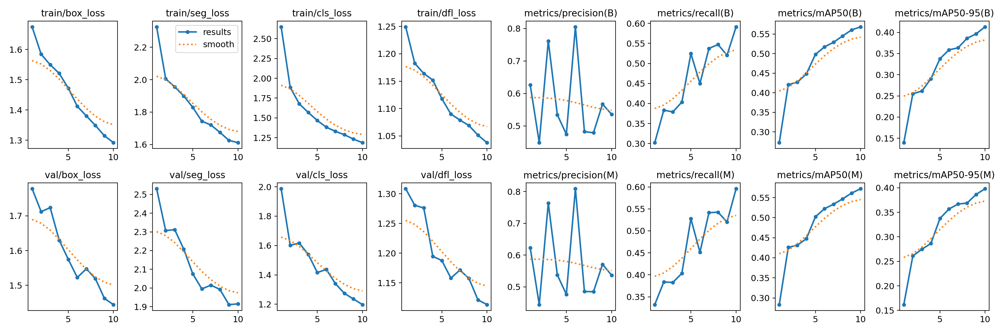


Validation Metrics (Confusion Matrix):


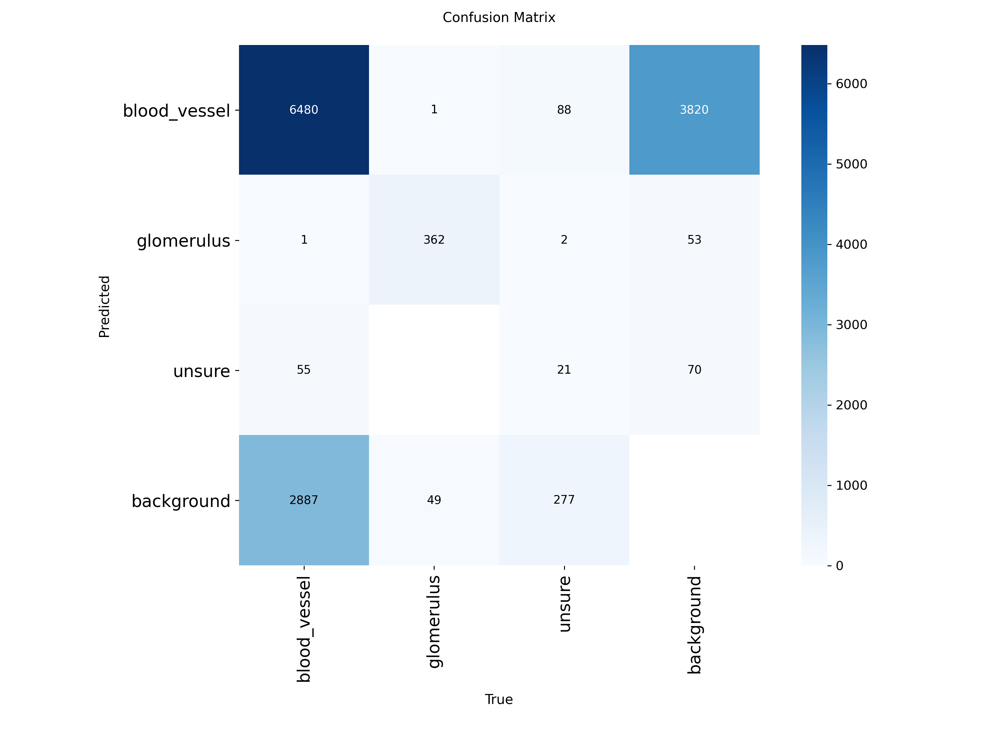

In [15]:
# The 'results' object contains the path to the run
run_dir = results.save_dir  # This gets the directory, e.g., 'Microscope-YOLO/run1'

print(f"Training results saved to: {run_dir}")

# Display the training and validation loss curves
# These are required by the assignment PDF 
print("\nTraining/Validation Loss Curves:")
display(Image(filename=f"{run_dir}/results.png", width=800))

# Display the validation metrics (mAP@0.5, etc.)
# This shows the mAP@0.5 or IoU scores 
print("\nValidation Metrics (Confusion Matrix):")
display(Image(filename=f"{run_dir}/confusion_matrix.png", width=600))

In [7]:
print("\n" + "=" * 60)
print("VALIDATION METRICS")
print("=" * 60)

run_dir = results.save_dir if hasattr(results, "save_dir") else "/kaggle/working/yolo12_runs/detect_yolo12_seg"
best_ckpt = os.path.join(run_dir, "weights", "best.pt")

if os.path.exists(best_ckpt):
    print(f"Loading best weights: {best_ckpt}")
    model = YOLO(best_ckpt)
    
    val_metrics = model.val(split="val")
    
    print(f"\nValidation Results:")
    print(f"  Box mAP50-95: {val_metrics.box.map:.4f}")
    print(f"  Box mAP50: {val_metrics.box.map50:.4f}")
    print(f"  Mask mAP50-95: {val_metrics.seg.map:.4f}")
    print(f"  Mask mAP50: {val_metrics.seg.map50:.4f}")
else:
    print("Best checkpoint not found!")


VALIDATION METRICS
Loading best weights: /kaggle/working/yolo12_runs/detect_yolo12_seg/weights/best.pt
Ultralytics 8.3.224 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLOv8n-seg summary (fused): 85 layers, 3,258,649 parameters, 0 gradients
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 52.4±4.5 MB/s, size: 57.7 KB)
val: Scanning /kaggle/input/microscopic-yolov8/valid/labels... 1398 images, 141 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 1398/1398 389.7it/s 3.6s0.1s
val: /kaggle/input/microscopic-yolov8/valid/images/0bc3e1a729e4_png.rf.4b595197042c4e9f6e0c6341ca4f71ae.jpg: 7 duplicate labels removed
val: /kaggle/input/microscopic-yolov8/valid/images/0ce440ad7080_png.rf.c026dfd05242f5eecb4d297004ef710e.jpg: 13 duplicate labels removed
val: /kaggle/input/microscopic-yolov8/valid/images/0f6e1cb07f74_png.rf.47d7e5cdecba17ad46ef63bf6c3074cd.jpg: 8 duplicate labels removed
val: /kaggle/input/microscopic-yolov8/valid/images/1b5da995f08e_png.rf.470925a68bbfd3b4

/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all       1398      10223      0.564      0.624      0.594      0.439      0.575      0.605      0.594      0.411
          blood_vessel       1231       9423      0.556      0.769      0.708      0.393      0.581      0.747      0.704      0.327
            glomerulus        361        412      0.873      0.888      0.931      0.837      0.881      0.884      0.931      0.827
                unsure        156        388      0.263      0.214      0.143     0.0855      0.261      0.186      0.147     0.0782
Speed: 1.3ms preprocess, 2.9ms inference, 0.0ms loss, 1.8ms postprocess per image
Results saved to /kaggle/working/runs/segment/val

Validation Results:
  Box mAP50-95: 0.4385
  Box mAP50: 0.5939
  Mask mAP50-95: 0.4109
  Mask mAP50: 0.5943


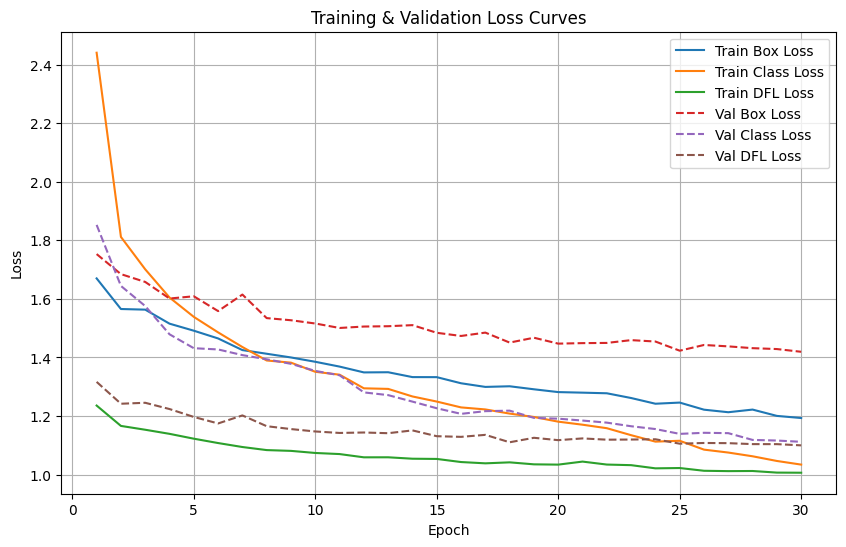

In [8]:
results_dir = '/kaggle/working/yolo12_runs/detect_yolo12_seg'

results_csv = os.path.join(results_dir, "results.csv")
results = pd.read_csv(results_csv)

# Plot key losses
plt.figure(figsize=(10, 6))
plt.plot(results["epoch"], results["train/box_loss"], label="Train Box Loss")
plt.plot(results["epoch"], results["train/cls_loss"], label="Train Class Loss")
plt.plot(results["epoch"], results["train/dfl_loss"], label="Train DFL Loss")
plt.plot(results["epoch"], results["val/box_loss"], '--', label="Val Box Loss")
plt.plot(results["epoch"], results["val/cls_loss"], '--', label="Val Class Loss")
plt.plot(results["epoch"], results["val/dfl_loss"], '--', label="Val DFL Loss")

plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Training & Validation Loss Curves")
plt.legend()
plt.grid(True)
plt.show()

In [9]:

print("\n" + "=" * 60)
print("TEST INFERENCE")
print("=" * 60)
    
test_img_dir = os.path.join(DATASET_ROOT, 'test', 'images')
test_imgs = glob.glob(os.path.join(test_img_dir, '*.*'))
test_imgs = [f for f in test_imgs if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    
if len(test_imgs) > 0:
    sample_imgs = random.sample(test_imgs, min(6, len(test_imgs)))
        
    print(f"Running inference on {len(sample_imgs)} test images...")
    predictions = model.predict(
        source=sample_imgs,
        imgsz=640,
        conf=0.25,
        verbose=False,
        save=False
    )
        


TEST INFERENCE
Running inference on 6 test images...


In [10]:
def draw_gt_polygons(img_path, label_path, class_names):
    """Draw ground truth segmentation polygons."""
    img = cv2.imread(img_path)
    if img is None:
        return None
    
    h, w = img.shape[:2]
    overlay = img.copy()

    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            for line in f:
                vals = list(map(float, line.strip().split()))
                cls_id = int(vals[0])
                coords = vals[1:]
                
                if len(coords) > 4:
                    pts = np.array(coords).reshape(-1, 2)
                    pts[:, 0] *= w
                    pts[:, 1] *= h
                    pts = pts.astype(np.int32)
                    
                    color = (0, 255, 0)  # Green for GT
                    cv2.fillPoly(overlay, [pts], color)
                    cv2.polylines(overlay, [pts], True, (255, 255, 255), 2)
                    
                    label = class_names[cls_id] if cls_id < len(class_names) else str(cls_id)
                    cv2.putText(overlay, f"GT: {label}", (pts[0][0], pts[0][1] - 10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2)
    
    return cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB)

def draw_pred_polygons(result):
    """Draw predicted segmentation polygons."""
    img = result.orig_img.copy()

    if hasattr(result, 'masks') and result.masks is not None:
        for i, seg in enumerate(result.masks.xy):
            poly = np.array(seg, dtype=np.int32)
            color = (0, 0, 255)  # Red for predictions
            cv2.fillPoly(img, [poly], color)
            cv2.polylines(img, [poly], True, (255, 255, 255), 2)
            
            if hasattr(result, 'boxes') and result.boxes.cls is not None:
                cls_id = int(result.boxes.cls[i].item())
                conf = float(result.boxes.conf[i].item())
                label = result.names.get(cls_id, str(cls_id))
                x, y = poly[0]
                cv2.putText(img, f"{label} {conf:.2f}", (int(x), int(y) - 6),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2)
    
    return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)


PREDICTION AND VISUALIZATION
Running inference on 4 test images...


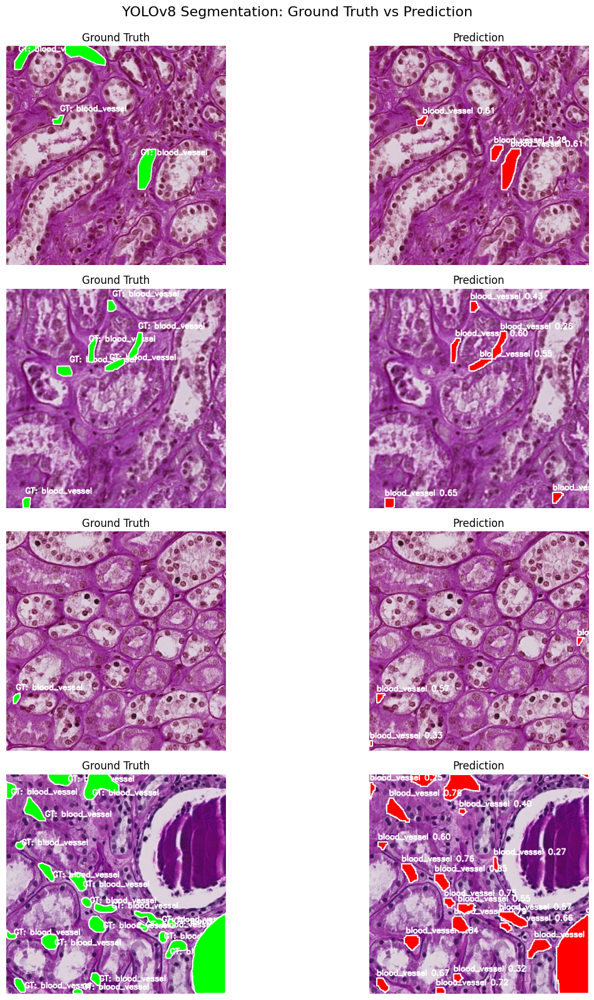


All done!


In [11]:
print("\n" + "=" * 60)
print("PREDICTION AND VISUALIZATION")
print("=" * 60)

test_imgs = glob.glob(os.path.join(IMAGES_TEST, "*.*"))
test_imgs = [f for f in test_imgs if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
sample_imgs = random.sample(test_imgs, min(4, len(test_imgs)))

print(f"Running inference on {len(sample_imgs)} test images...")
preds = model.predict(source=sample_imgs, imgsz=640, conf=0.25, save=False, verbose=False)

fig, axes = plt.subplots(len(preds), 2, figsize=(14, 4 * len(preds)))
if len(preds) == 1:
    axes = axes.reshape(1, -1)

for i, result in enumerate(preds):
    img_path = result.path
    label_path = os.path.join(LABELS_TEST, 
                              os.path.basename(img_path).rsplit('.', 1)[0] + '.txt')
    
    vis_gt = draw_gt_polygons(img_path, label_path, CLASS_NAMES)
    vis_pred = draw_pred_polygons(result)
    
    axes[i, 0].imshow(vis_gt)
    axes[i, 0].set_title("Ground Truth", fontsize=12)
    axes[i, 0].axis('off')
    
    axes[i, 1].imshow(vis_pred)
    axes[i, 1].set_title("Prediction", fontsize=12)
    axes[i, 1].axis('off')

plt.suptitle("YOLOv8 Segmentation: Ground Truth vs Prediction", fontsize=16, y=0.995)
plt.tight_layout()
plt.show()

print("\nAll done!")

### 3.1.6. Visualize Predictions

In [16]:
# Load the best trained model
best_model = YOLO(f'{run_dir}/weights/best.pt')

# Get some test images
TEST_IMAGE_DIR = "/kaggle/input/microscopic-yolov8/test/images"
test_images = [os.path.join(TEST_IMAGE_DIR, f) for f in os.listdir(TEST_IMAGE_DIR)][:4]

# Run prediction
predict_results = best_model.predict(test_images, save=True)

# Display the prediction results
print("\nTest Set Predictions:")
for i, img_path in enumerate(test_images):
    pred_path = f"{run_dir}/predict/image{i+1}.jpg" # Default save path
    if os.path.exists(pred_path):
        print(f"Displaying prediction for: {img_path}")
        display(Image(filename=pred_path, width=600))
    else:
        # Fallback if prediction image not found at that exact path
        print(f"Prediction for {img_path} done. Check 'runs/segment/predict' folder.")


0: 640x640 10 blood_vessels, 11.7ms
1: 640x640 2 blood_vessels, 11.7ms
2: 640x640 5 blood_vessels, 11.7ms
3: 640x640 3 blood_vessels, 11.7ms
Speed: 4.3ms preprocess, 11.7ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /kaggle/working/runs/segment/predict

Test Set Predictions:
Prediction for /kaggle/input/microscopic-yolov8/test/images/04a594cb9b06_png.rf.6c4a85a334d254ac6179ea8565297a09.jpg done. Check 'runs/segment/predict' folder.
Prediction for /kaggle/input/microscopic-yolov8/test/images/8fe768923b4f_png.rf.6be595aeefb7819758a7eefdb7f4d33a.jpg done. Check 'runs/segment/predict' folder.
Prediction for /kaggle/input/microscopic-yolov8/test/images/3766892da10f_png.rf.f4987f8ac96c311c31af3984e09b65dd.jpg done. Check 'runs/segment/predict' folder.
Prediction for /kaggle/input/microscopic-yolov8/test/images/8fce09784a4c_png.rf.96626cf2ef70f4a48967faba443ca34d.jpg done. Check 'runs/segment/predict' folder.


In [17]:
import os
from ultralytics import YOLO

# 1. Locate the run directory from the 'results' object (from training)
# This assumes the 'results = model.train(...)' cell has been run.
try:
    run_dir = results.save_dir
    print(f"Located training run directory: {run_dir}")
except NameError:
    print("Warning: 'results' object not found. Using default path.")
    # Fallback path based on your project settings
    run_dir = "/kaggle/working/Microscope-YOLO/run1" 
    if not os.path.exists(run_dir):
        print(f"Error: Fallback path {run_dir} not found. Please run training first.")
        # This will stop the script if the directory is missing
        raise FileNotFoundError(f"Could not find training directory at {run_dir}")

# 2. Construct the path to the best model weights
best_ckpt = os.path.join(run_dir, "weights", "best.pt")

if not os.path.exists(best_ckpt):
    print(f"Error: Best weights not found at {best_ckpt}. Please ensure training completed.")
else:
    print(f"Using best weights from: {best_ckpt}")

    # 3. Load the best model
    model = YOLO(best_ckpt)

    # 4. Run validation on the 'val' set specified in your data.yaml
    # This will print a summary table and save new plots
    val_metrics = model.val(
        data='/kaggle/working/data.yaml', 
        split='val',
        project='Microscope-YOLO',
        name='validation-on-best' # Saves val results to a new folder
    )
    
    # 5. Print the key metrics programmatically
    print("\n--- Programmatic Validation Metrics (from best.pt) ---")
    try:
        print("--- Box Metrics (Bounding Box) ---")
        print(f"Box mAP50-95:   {val_metrics.box.map}")
        print(f"Box mAP50:      {val_metrics.box.map50}")
        print(f"Box mAP75:      {val_metrics.box.map75}")
        
        print("\n--- Mask Metrics (Segmentation) ---")
        print(f"Mask mAP50-95:  {val_metrics.seg.map}")
        print(f"Mask mAP50:     {val_metrics.seg.map50}")
        print(f"Mask mAP75:     {val_metrics.seg.map75}")

    except AttributeError:
        print("Could not access 'val_metrics.box.map' or 'val_metrics.seg.map'.")
        print("Printing all available metrics keys:")
        print(val_metrics.box.metrics_map.keys())
    except Exception as e:
        print(f"An error occurred while accessing metrics: {e}")

    print(f"\nValidation plots (PR curves, F1) saved to 'Microscope-YOLO/validation-on-best'")

Located training run directory: /kaggle/working/Microscope-YOLO/run12
Using best weights from: /kaggle/working/Microscope-YOLO/run12/weights/best.pt
Ultralytics 8.3.223 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8n-seg summary (fused): 85 layers, 3,258,649 parameters, 0 gradients, 11.3 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 128.8±24.8 MB/s, size: 56.6 KB)
val: Scanning /kaggle/input/microscopic-yolov8/valid/labels... 1398 images, 141 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 1398/1398 512.9it/s 2.7s0.0s
val: /kaggle/input/microscopic-yolov8/valid/images/0bc3e1a729e4_png.rf.4b595197042c4e9f6e0c6341ca4f71ae.jpg: 7 duplicate labels removed
val: /kaggle/input/microscopic-yolov8/valid/images/0ce440ad7080_png.rf.c026dfd05242f5eecb4d297004ef710e.jpg: 13 duplicate labels removed
val: /kaggle/input/microscopic-yolov8/valid/images/0f6e1cb07f74_png.rf.47d7e5cdecba17ad46ef63bf6c3074cd.jpg: 8 duplicate labels removed
val: /kaggle/input/microscopic-yolov8/v

/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all       1398      10223      0.536      0.591      0.569      0.413      0.536      0.594      0.571      0.396
          blood_vessel       1231       9423      0.555      0.736      0.682      0.375      0.554      0.739      0.682      0.316
            glomerulus        361        412      0.823      0.886      0.911      0.807      0.822      0.886      0.915      0.816
                unsure        156        388      0.229      0.152      0.114     0.0585      0.231      0.157      0.116     0.0557
Speed: 1.2ms preprocess, 4.8ms inference, 0.0ms loss, 3.5ms postprocess per image
Results saved to /kaggle/working/Microscope-YOLO/validation-on-best

--- Programmatic Validation Metrics (from best.pt) ---
--- Box Metrics (Bounding Box) ---
Box mAP50-95:   0.4133855911247725
Box mAP50:      0.5689452029690919
Box mAP75:      0.43065598569843505

--- Mask Metrics (Segmentation) ---
Mask mAP50-95:  0.3961609441437724
Mask mAP50:     0.5711624644840291
Mask mAP75:   

In [18]:
import os

print("\n" + "="*30)
print("--- Evaluating on Test Split ---")
print("="*30)

try:
    # Ensure the 'model' variable (e.g., model = YOLO(best_ckpt))
    # is defined and loaded from the previous step.

    # We MUST specify the 'data' config file so it knows where the 'test' split is
    test_metrics = model.val(
        data='/kaggle/working/data.yaml', 
        split='test',
        project='Microscope-YOLO',
        name='test-evaluation'  # Saves results to a new folder
    )
    
    print("\n--- Programmatic Test Metrics (from test split) ---")
    try:
        print("--- Test Box Metrics (Bounding Box) ---")
        print(f"Test Box mAP50-95:   {test_metrics.box.map}")
        print(f"Test Box mAP50:      {test_metrics.box.map50}")
        print(f"Test Box mAP75:      {test_metrics.box.map75}")

        print("\n--- Test Mask Metrics (Segmentation) ---")
        print(f"Test Mask mAP50-95:  {test_metrics.seg.map}")
        print(f"Test Mask mAP50:     {test_metrics.seg.map50}")
        print(f"Test Mask mAP75:     {test_metrics.seg.map75}")
        
        print(f"\nTest evaluation plots (PR curves, etc.) saved to 'Microscope-YOLO/test-evaluation'")

    except AttributeError:
        print("Could not access 'test_metrics.box.map' or 'test_metrics.seg.map'.")
    except Exception as e_inner:
        print(f"An error occurred while accessing test metrics: {e_inner}")

except Exception as e:
    print(f"\nTest evaluation skipped or failed: {e}")
    print("This often means the 'test:' key is not defined in your '/kaggle/working/data.yaml' file.")


--- Evaluating on Test Split ---
Ultralytics 8.3.223 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
val: Fast image access ✅ (ping: 0.2±0.2 ms, read: 16.3±2.0 MB/s, size: 57.1 KB)
val: Scanning /kaggle/input/microscopic-yolov8/test/labels... 685 images, 99 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 685/685 370.1it/s 1.9s<0.0s
val: /kaggle/input/microscopic-yolov8/test/images/025ec20b8b73_png.rf.b848759160f5108e06c9ab127fdee7e2.jpg: 7 duplicate labels removed
val: /kaggle/input/microscopic-yolov8/test/images/3398c337fe7a_png.rf.b3279679a0f1d5a6052cac5f790e2ccf.jpg: 8 duplicate labels removed
val: /kaggle/input/microscopic-yolov8/test/images/4995f7836ec4_png.rf.07fdcc55eb1be3b5b0312e34976d65fd.jpg: 3 duplicate labels removed
val: /kaggle/input/microscopic-yolov8/test/images/a12848a1b5f9_png.rf.53902d2db7f8be7f4594020e919cfa13.jpg: 1 duplicate labels removed
val: /kaggle/input/microscopic-yolov8/test/images/fa6a66f01888_png.rf.100a17655d50e88d17bc02d9e7c98ce1.jpg: 11 dupli

/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all        685       2747      0.551      0.694       0.64      0.493      0.548      0.688      0.636      0.466
          blood_vessel        565       2546      0.518       0.81      0.717       0.46      0.507      0.793      0.703      0.352
            glomerulus        159        182      0.817      0.956      0.965      0.874      0.817      0.956      0.965       0.89
                unsure          9         19      0.319      0.316       0.24      0.145      0.319      0.316       0.24      0.156
Speed: 1.5ms preprocess, 4.9ms inference, 0.0ms loss, 4.2ms postprocess per image
Results saved to /kaggle/working/Microscope-YOLO/test-evaluation

--- Programmatic Test Metrics (from test split) ---
--- Test Box Metrics (Bounding Box) ---
Test Box mAP50-95:   0.4928484455075883
Test Box mAP50:      0.6402708698761231
Test Box mAP75:      0.5472417520305625

--- Test Mask Metrics (Segmentation) ---
Test Mask mAP50-95:  0.46601683750836337
Test Mask mAP50:     0.63

Selected 4 random test images.

0: 640x640 2 blood_vessels, 7.0ms
1: 640x640 17 blood_vessels, 1 glomerulus, 7.0ms
2: 640x640 (no detections), 7.0ms
3: 640x640 7 blood_vessels, 7.0ms
Speed: 2.2ms preprocess, 7.0ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)
⚠️ No predicted masks found for: /kaggle/input/microscopic-yolov8/test/images/df941ba3ae69_png.rf.2d3a979a09e5f5a86d7d60ca68bd16b2.jpg


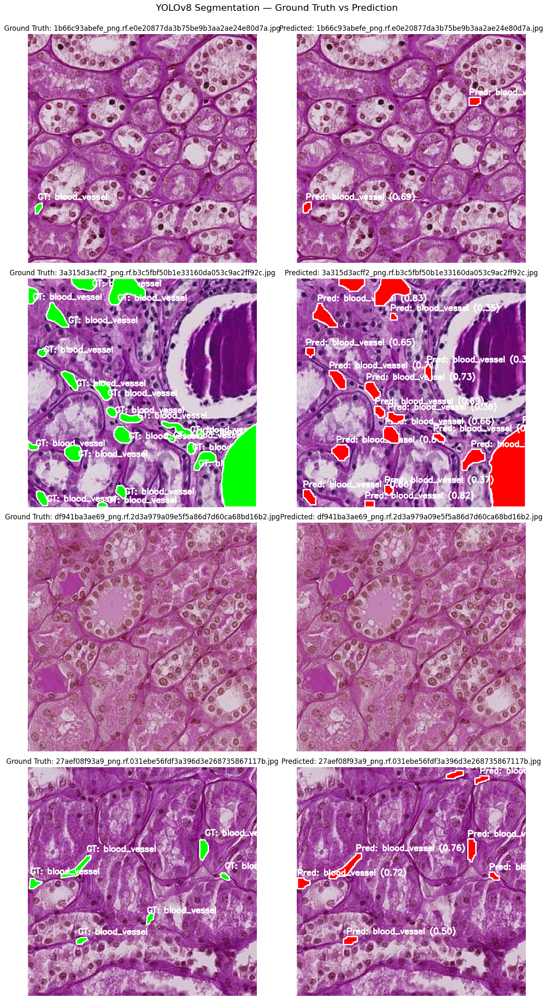

In [20]:
# ============================================================
# YOLOv8 Segmentation — Predicted vs Ground Truth Comparison
# ============================================================
import os
import glob
import random
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO # Make sure YOLO is imported

# --- CONFIGURATION (Corrected for your dataset) ---
TEST_IMAGE_DIR = "/kaggle/input/microscopic-yolov8/test/images"
TEST_LABEL_DIR = "/kaggle/input/microscopic-yolov8/test/labels"
CLASS_NAMES = ['blood_vessel', 'glomerulus', 'unsure']

# Ensure the 'model' variable is loaded from your best checkpoint
# (This assumes 'model = YOLO(best_ckpt)' was run in a previous cell)
if 'model' not in globals():
    print("Model not found. Loading 'best.pt' from default 'run1' directory...")
    try:
        run_dir = "/kaggle/working/Microscope-YOLO/run1"
        best_ckpt = os.path.join(run_dir, "weights", "best.pt")
        model = YOLO(best_ckpt)
        print(f"Successfully loaded {best_ckpt}")
    except Exception as e:
        print(f"Error loading model: {e}. Please run the training/validation cells first.")
# ---------------------------------------------------

# Pick a few random test images
sample_imgs = []
if os.path.isdir(TEST_IMAGE_DIR):
    all_imgs = [p for p in glob.glob(os.path.join(TEST_IMAGE_DIR, "*.*"))
                if p.lower().endswith((".jpg", ".jpeg", ".png", ".bmp", ".tif", ".tiff"))]
    
    if len(all_imgs) > 0:
        sample_imgs = random.sample(all_imgs, min(4, len(all_imgs)))
        print(f"Selected {len(sample_imgs)} random test images.")
    else:
        print(f"Error: No images found in {TEST_IMAGE_DIR}")
else:
    print(f"Error: Test directory not found at {TEST_IMAGE_DIR}")

# ------------------------------------------------------------
# Helper to draw polygons from YOLO label file (Ground Truth)
# (Class names default is updated for your dataset)
# ------------------------------------------------------------
def draw_gt_polygons(img_path, label_path, class_names):
    img = cv2.imread(img_path)
    if img is None:
        print(f"⚠️ Error reading image {img_path}")
        return np.zeros((640, 640, 3), dtype=np.uint8)
        
    h, w = img.shape[:2]
    overlay = img.copy()

    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            for line in f:
                try:
                    vals = list(map(float, line.strip().split()))
                    cls_id = int(vals[0])
                    coords = vals[1:]
                    if len(coords) > 4:
                        pts = np.array(coords).reshape(-1, 2)
                        pts[:, 0] *= w
                        pts[:, 1] *= h
                        pts = pts.astype(np.int32)
                        color = (0, 255, 0)  # green for GT
                        cv2.fillPoly(overlay, [pts], color)
                        cv2.polylines(overlay, [pts], True, (255, 255, 255), 2)
                        label = class_names[cls_id] if cls_id < len(class_names) else f"ID {cls_id}"
                        cv2.putText(overlay, f"GT: {label}", (pts[0][0], pts[0][1] - 10),
                                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,255,255), 2)
                except Exception as e:
                    print(f"Error processing line in {label_path}: {e}")
    else:
        print(f"⚠️ No label file found for {os.path.basename(img_path)}")

    return overlay

# ------------------------------------------------------------
# Helper to draw predicted polygons (This function is correct)
# ------------------------------------------------------------
def draw_pred_polygons(result):
    img = result.orig_img.copy()

    if getattr(result, "masks", None) is not None and result.masks is not None:
        for i, seg in enumerate(result.masks.xy):
            poly = np.array(seg, dtype=np.int32)
            color = (0, 0, 255)  # red for predictions
            cv2.fillPoly(img, [poly], color)
            cv2.polylines(img, [poly], True, (255, 255, 255), 2)
            
            if getattr(result, "names", None) is not None and getattr(result.boxes, "cls", None) is not None:
                cls_id = int(result.boxes.cls[i].item())
                conf = float(result.boxes.conf[i].item())
                
                # Get label name
                if isinstance(result.names, dict):
                    label = result.names.get(cls_id, str(cls_id))
                else:
                    label = str(cls_id)
                
                x, y = poly[0]
                cv2.putText(img, f"Pred: {label} ({conf:.2f})", (int(x), int(y) - 6),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,255,255), 2)
    else:
        print("⚠️ No predicted masks found for:", result.path)

    return img

# ------------------------------------------------------------
# Run inference on test set
# ------------------------------------------------------------
if sample_imgs:
    preds = model.predict(source=sample_imgs, imgsz=640, conf=0.25, save=False)
else:
    preds = []
    print("Skipping prediction as no sample images were found.")

# ------------------------------------------------------------
# Plot Predicted vs Ground Truth
# ------------------------------------------------------------
if preds:
    num_preds = len(preds)
    plt.figure(figsize=(14, 6 * num_preds)) # Adjusted height

    for i, result in enumerate(preds):
        img_path = result.path
        # Construct label path based on test label directory
        label_filename = os.path.basename(img_path).replace(".jpg", ".txt").replace(".png", ".txt")
        label_path = os.path.join(TEST_LABEL_DIR, label_filename)
        
        # Prepare visualizations
        vis_pred = draw_pred_polygons(result)
        
        # ✅ *** CORRECTION HERE ***
        # Pass the correct CLASS_NAMES to the GT function
        vis_gt = draw_gt_polygons(img_path, label_path, CLASS_NAMES)

        vis_pred_rgb = cv2.cvtColor(vis_pred, cv2.COLOR_BGR2RGB)
        vis_gt_rgb = cv2.cvtColor(vis_gt, cv2.COLOR_BGR2RGB)

        # Show side by side
        plt.subplot(num_preds, 2, 2*i + 1)
        plt.imshow(vis_gt_rgb)
        plt.title(f"Ground Truth: {os.path.basename(img_path)}")
        plt.axis("off")

        plt.subplot(num_preds, 2, 2*i + 2)
        plt.imshow(vis_pred_rgb)
        plt.title(f"Predicted: {os.path.basename(img_path)}")
        plt.axis("off")

    # ✅ *** CORRECTION HERE ***
    plt.suptitle("YOLOv8 Segmentation — Ground Truth vs Prediction", fontsize=16, y=1.0)
    plt.tight_layout()
    plt.show()


Scanning test set for class examples...

--- Image Search Report ---
Found 2/2 images for 'blood_vessel'
Found 2/2 images for 'glomerulus'
Found 2/2 images for 'unsure'

Total unique images to predict: 6

0: 640x640 1 glomerulus, 7.6ms
1: 640x640 3 blood_vessels, 1 glomerulus, 7.6ms
2: 640x640 3 blood_vessels, 1 unsure, 7.6ms
3: 640x640 6 blood_vessels, 7.6ms
4: 640x640 9 blood_vessels, 7.6ms
5: 640x640 5 blood_vessels, 1 unsure, 7.6ms
Speed: 2.3ms preprocess, 7.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

--- Plotting 6 comparison images ---


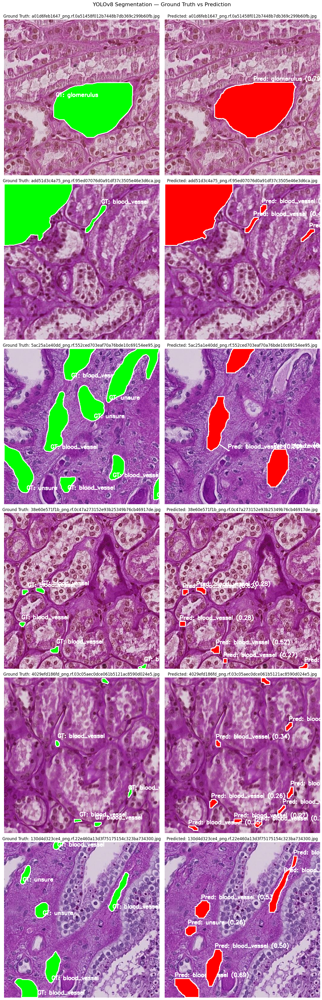

In [21]:
# ============================================================
# YOLOv8 Segmentation — Predicted vs Ground Truth Comparison
# (Finds >= 2 images per class)
# ============================================================
import os
import glob
import random
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO # Make sure YOLO is imported

# --- CONFIGURATION (Corrected for your dataset) ---
TEST_IMAGE_DIR = "/kaggle/input/microscopic-yolov8/test/images"
TEST_LABEL_DIR = "/kaggle/input/microscopic-yolov8/test/labels"
CLASS_NAMES = ['blood_vessel', 'glomerulus', 'unsure']
TARGET_IMAGES_PER_CLASS = 2

# Ensure the 'model' variable is loaded from your best checkpoint
# (This assumes 'model = YOLO(best_ckpt)' was run in a previous cell)
if 'model' not in globals():
    print("Model not found. Loading 'best.pt' from default 'run1' directory...")
    try:
        run_dir = "/kaggle/working/Microscope-YOLO/run1"
        best_ckpt = os.path.join(run_dir, "weights", "best.pt")
        model = YOLO(best_ckpt)
        print(f"Successfully loaded {best_ckpt}")
    except Exception as e:
        print(f"Error loading model: {e}. Please run the training/validation cells first.")
# ---------------------------------------------------

# ------------------------------------------------------------
# NEW: Find at least 2 images per class from the test set
# ------------------------------------------------------------
print("\nScanning test set for class examples...")
class_image_map = {name: [] for name in CLASS_NAMES}
images_to_predict = set() # Use a set to avoid duplicate predictions

all_label_files = []
if os.path.isdir(TEST_LABEL_DIR):
    all_label_files = os.listdir(TEST_LABEL_DIR)
    random.shuffle(all_label_files) # Shuffle to get varied examples
else:
    print(f"Error: Label directory not found at {TEST_LABEL_DIR}")

if all_label_files:
    # Helper to check which classes still need images
    def classes_needed():
        return [name for name, img_list in class_image_map.items() if len(img_list) < TARGET_IMAGES_PER_CLASS]

    # Loop until we find enough images or run out of files
    for label_file in all_label_files:
        needed = classes_needed()
        if not needed:
            #print("Found all required images.")
            break # Stop if all classes have enough images

        label_path = os.path.join(TEST_LABEL_DIR, label_file)
        
        # Find the corresponding image path (handles .jpg, .png, etc.)
        img_name_base = os.path.splitext(label_file)[0]
        img_path = None
        for ext in ['.jpg', '.png', '.jpeg', '.bmp', '.tif', '.tiff']:
            potential_path = os.path.join(TEST_IMAGE_DIR, img_name_base + ext)
            if os.path.exists(potential_path):
                img_path = potential_path
                break
        
        if not img_path:
            continue # Skip if no matching image file

        # Read the label file to find which classes are present
        present_classes = set()
        try:
            with open(label_path, "r") as f:
                for line in f:
                    try:
                        cls_id = int(line.strip().split()[0])
                        if 0 <= cls_id < len(CLASS_NAMES):
                            present_classes.add(CLASS_NAMES[cls_id])
                    except (ValueError, IndexError):
                        continue # Skip bad lines
        except Exception as e:
            #print(f"Error reading {label_file}: {e}")
            continue

        # Add this image to the lists for the classes it contains
        for class_name in present_classes:
            if class_name in needed and len(class_image_map[class_name]) < TARGET_IMAGES_PER_CLASS:
                class_image_map[class_name].append(img_path)
                images_to_predict.add(img_path) # Add to the master set

    # --- Report and assign ---
    print("\n--- Image Search Report ---")
    for class_name, img_list in class_image_map.items():
        print(f"Found {len(img_list)}/{TARGET_IMAGES_PER_CLASS} images for '{class_name}'")

    sample_imgs = list(images_to_predict)
    if not sample_imgs:
        print("Error: No images were found to match classes.")
    
    print(f"\nTotal unique images to predict: {len(sample_imgs)}")

else:
    print("Error: No label files found to scan.")
    sample_imgs = []
    
# ------------------------------------------------------------
# Helper to draw polygons from YOLO label file (Ground Truth)
# (Unchanged)
# ------------------------------------------------------------
def draw_gt_polygons(img_path, label_path, class_names):
    img = cv2.imread(img_path)
    if img is None:
        print(f"⚠️ Error reading image {img_path}")
        return np.zeros((640, 640, 3), dtype=np.uint8)
        
    h, w = img.shape[:2]
    overlay = img.copy()

    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            for line in f:
                try:
                    vals = list(map(float, line.strip().split()))
                    cls_id = int(vals[0])
                    coords = vals[1:]
                    if len(coords) > 4:
                        pts = np.array(coords).reshape(-1, 2)
                        pts[:, 0] *= w
                        pts[:, 1] *= h
                        pts = pts.astype(np.int32)
                        color = (0, 255, 0)  # green for GT
                        cv2.fillPoly(overlay, [pts], color)
                        cv2.polylines(overlay, [pts], True, (255, 255, 255), 2)
                        label = class_names[cls_id] if cls_id < len(class_names) else f"ID {cls_id}"
                        cv2.putText(overlay, f"GT: {label}", (pts[0][0], pts[0][1] - 10),
                                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,255,255), 2)
                except Exception as e:
                    print(f"Error processing line in {label_path}: {e}")
    else:
        print(f"⚠️ No label file found for {os.path.basename(img_path)}")

    return overlay

# ------------------------------------------------------------
# Helper to draw predicted polygons (Unchanged)
# ------------------------------------------------------------
def draw_pred_polygons(result):
    img = result.orig_img.copy()

    if getattr(result, "masks", None) is not None and result.masks is not None:
        for i, seg in enumerate(result.masks.xy):
            poly = np.array(seg, dtype=np.int32)
            color = (0, 0, 255)  # red for predictions
            cv2.fillPoly(img, [poly], color)
            cv2.polylines(img, [poly], True, (255, 255, 255), 2)
            
            if getattr(result, "names", None) is not None and getattr(result.boxes, "cls", None) is not None:
                cls_id = int(result.boxes.cls[i].item())
                conf = float(result.boxes.conf[i].item())
                
                if isinstance(result.names, dict):
                    label = result.names.get(cls_id, str(cls_id))
                else:
                    label = str(cls_id)
                
                x, y = poly[0]
                cv2.putText(img, f"Pred: {label} ({conf:.2f})", (int(x), int(y) - 6),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,255,255), 2)
    else:
        print("⚠️ No predicted masks found for:", result.path)

    return img

# ------------------------------------------------------------
# Run inference on the selected test images
# ------------------------------------------------------------
if sample_imgs:
    preds = model.predict(source=sample_imgs, imgsz=640, conf=0.25, save=False)
else:
    preds = []
    print("Skipping prediction as no sample images were found.")

# ------------------------------------------------------------
# Plot Predicted vs Ground Truth (Unchanged)
# ------------------------------------------------------------
if preds:
    num_preds = len(preds)
    plt.figure(figsize=(14, 7 * num_preds)) # Adjusted height
    print(f"\n--- Plotting {num_preds} comparison images ---")

    for i, result in enumerate(preds):
        img_path = result.path
        # Construct label path based on test label directory
        label_filename = os.path.basename(img_path).replace(".jpg", ".txt").replace(".png", ".txt")
        label_path = os.path.join(TEST_LABEL_DIR, label_filename)
        
        # Prepare visualizations
        vis_pred = draw_pred_polygons(result)
        vis_gt = draw_gt_polygons(img_path, label_path, CLASS_NAMES)

        vis_pred_rgb = cv2.cvtColor(vis_pred, cv2.COLOR_BGR2RGB)
        vis_gt_rgb = cv2.cvtColor(vis_gt, cv2.COLOR_BGR2RGB)

        # Show side by side
        plt.subplot(num_preds, 2, 2*i + 1)
        plt.imshow(vis_gt_rgb)
        plt.title(f"Ground Truth: {os.path.basename(img_path)}")
        plt.axis("off")

        plt.subplot(num_preds, 2, 2*i + 2)
        plt.imshow(vis_pred_rgb)
        plt.title(f"Predicted: {os.path.basename(img_path)}")
        plt.axis("off")

    plt.suptitle("YOLOv8 Segmentation — Ground Truth vs Prediction", fontsize=16, y=1.0)
    plt.tight_layout()
    plt.show()

#